In [2]:
import os, sys, time, tqdm, importlib, pickle, json
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import style
import seaborn as sns
import scanpy as sc
import squidpy as sq
import scipy.stats as ss
from scipy.spatial.distance import cdist
import gseapy
import cmasher as cmr
from sksurv.nonparametric import kaplan_meier_estimator
from scipy.stats import ranksums
import anndata as ad
from scipy.sparse import csr_matrix
from adjustText import adjust_text
from scipy.interpolate import make_smoothing_spline
import warnings
warnings.filterwarnings('ignore')
sys.path.append('../src')

style.use('seaborn-v0_8-white')
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

In [3]:
## data and res dir
xenium_data_dir = '../data/Xenium_lung'
xenium_res_dir = '../results/Xenium_lung'
ref_data_dir = '../data/references'

In [4]:
## maps
with open('../data/maps/lung_ct_name_map.json', 'r') as f:
    ct_name_dict = json.load(f)
with open('../data/maps/lung_ct_cmap.json', 'r') as f:
    ct_cmap_dict = json.load(f)
with open('../data/maps/niche_cmap.json', 'r') as f:
    niche_cmap_dict = json.load(f)
cmap_niche = mpl.colors.LinearSegmentedColormap.from_list("cmap_niche", list(niche_cmap_dict.values()), N=len(niche_cmap_dict))
cmap_ct = mpl.colors.LinearSegmentedColormap.from_list("cmap_ct", list(ct_cmap_dict.values()), N=len(ct_cmap_dict))

In [5]:
## data after qc
adata = sc.read(f"{xenium_data_dir}/lung.h5ad") 
adata

AnnData object with n_obs × n_vars = 171923 × 5001
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'x', 'y', 'n_counts', 'max_norm', 'cell_type_ori', 'pass_qc', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p', 'neighbors', 'pca', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [6]:
all_cts = adata.obs.cell_type.cat.categories
print(f'{len(all_cts)} cell types.')

21 cell types.


In [7]:
import niche_detection
importlib.reload(niche_detection)
from niche_detection import nichescope

In [8]:
import utils
importlib.reload(utils)
from utils import *

# Data

## Cell type distribution

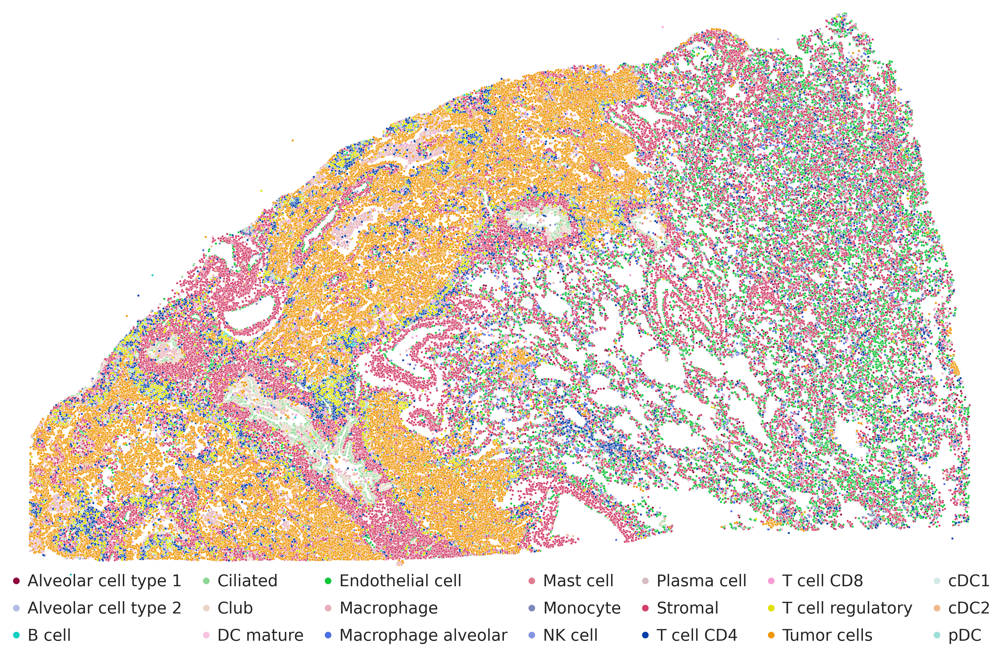

In [367]:
## cell type distribution
s = 4
alpha = 1
lw = 0.2
leg_font = 14
leg_mks = 3
ecolor = 'white'
fig, ax = plt.subplots(figsize=(15,9), dpi=300)
for ct in all_cts:
    color = ct_cmap_dict[ct]
    points = adata.obs.loc[adata.obs.cell_type==ct].copy()
    ax.scatter(points['x'], points['y'], s=s, c=color, alpha=alpha, edgecolors=ecolor, linewidths=lw, label=ct)
leg = ax.legend(bbox_to_anchor=(0.5,-0.05), loc="center", ncol=7, borderpad=0, borderaxespad=0, labelspacing=0.7,
          framealpha=0, markerscale=leg_mks, fontsize=leg_font, handletextpad=0.2)
# legend_title_left(leg)
ax.margins(0.01,0.01)
plt.gca().invert_yaxis()
plt.axis('off')
plt.show()

## Clustering on neighborhood composition

In [ ]:
## compute neighborhood composition matrix


# Tumor cell niche detection
Run NicheScope with tumor cell as target cell type on Xenium lung cancer.

In [9]:
target_ct = 'Tumor cells'
sigma = 20
cca_comp = 10
px = 0.6
pz = 0.6

In [10]:
## run nichescope
meta = nichescope(adata, 
                   target_ct, 
                   sigma=sigma, 
                   cov_test_null=True,
                   cca_comp=cca_comp, 
                   px=px, 
                   pz=pz)

[2025-08-02 17:43:32] [nichescope] [INFO] Dataset summary: 171923 cells, 5001 genes.
[2025-08-02 17:43:32] [nichescope] [INFO] 21 cell types: ['Alveolar cell type 1', 'Alveolar cell type 2', 'B cell', 'Ciliated', 'Club', 'DC mature', 'Endothelial cell', 'Macrophage', 'Macrophage alveolar', 'Mast cell', 'Monocyte', 'NK cell', 'Plasma cell', 'Stromal', 'T cell CD4', 'T cell CD8', 'T cell regulatory', 'Tumor cells', 'cDC1', 'cDC2', 'pDC'].

[2025-08-02 17:44:22] [nichescope] [INFO] Computed neighborhood composition matrix N of shape (28891, 21).
[2025-08-02 17:44:37] [nichescope] [INFO] Nonneg CCA cors: [0.6   0.391 0.289 0.441 0.619 0.235 0.223 0.245 0.579 0.322]

[2025-08-02 17:44:38] [nichescope] [INFO] NicheScope on Tumor cells: Finished in 65.8s.


In [12]:
## save result
with open(f'{xenium_res_dir}/lung_tumor.pkl', 'wb') as f:
    pickle.dump(meta, f)

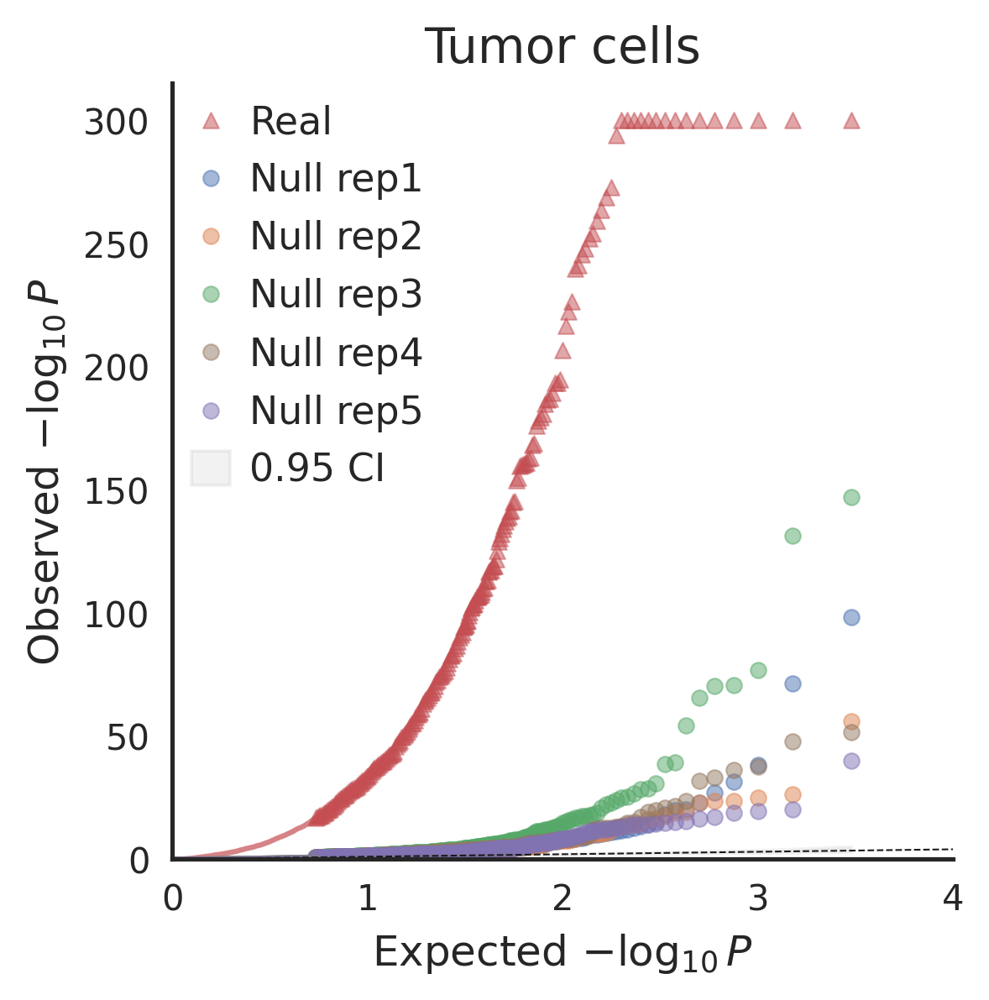

In [22]:
## cov test qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=300)
qqplot(meta['cov_real_null'], ['Real']+[f'Null rep{i}' for i in range(1,6)], ms=20,
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['^','o','o','o','o','o'], 
       distribution='beta', ax=ax, title='Tumor cells')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Main results
Analysis of tumor cell niche 1, 2 and 3. Note: Niche 1/2/3 are not necessarily the first/second/third CCA components. They are EMT/immune-, hypoxia- and neuron-associated niches, and we named them as niche 1, 2 and 3. Specifically, niche 1 corresponds to CCA component 3; niche 2 corresponds to the aggregation of CCA component 2 and 6; niche 3 corresponds to the aggregation of CCA component 1, 5 and 9. Due to sparsity constraint in sparse CCA, some later components resemble the earlier component as complementary niche signals. To more comprehensively represent such niches, we merge spatially and functionally similar components.

In [9]:
## load result
with open(f'{xenium_res_dir}/lung_tumor.pkl', 'rb') as f:
    meta = pickle.load(f)

In [10]:
## combine similar components
udf, vdf, score_df = meta['udf'], meta['vdf'], meta['score_df']
udf['niche1'] = udf['comp3']
udf['niche2'] = udf['comp2'] + udf['comp6']
udf['niche3'] = udf['comp1'] + udf['comp5'] + udf['comp9']
vdf['niche1'] = vdf['comp3']
vdf['niche2'] = vdf['comp2'] + vdf['comp6']
vdf['niche3'] = vdf['comp1'] + vdf['comp5'] + vdf['comp9']
score_df['S_niche1'] = score_df['S_comp3']
score_df['S_niche2'] = score_df['S_comp2'] + score_df['S_comp6']
score_df['S_niche3'] = score_df['S_comp1'] + score_df['S_comp5'] + score_df['S_comp9']

## Niche cell types

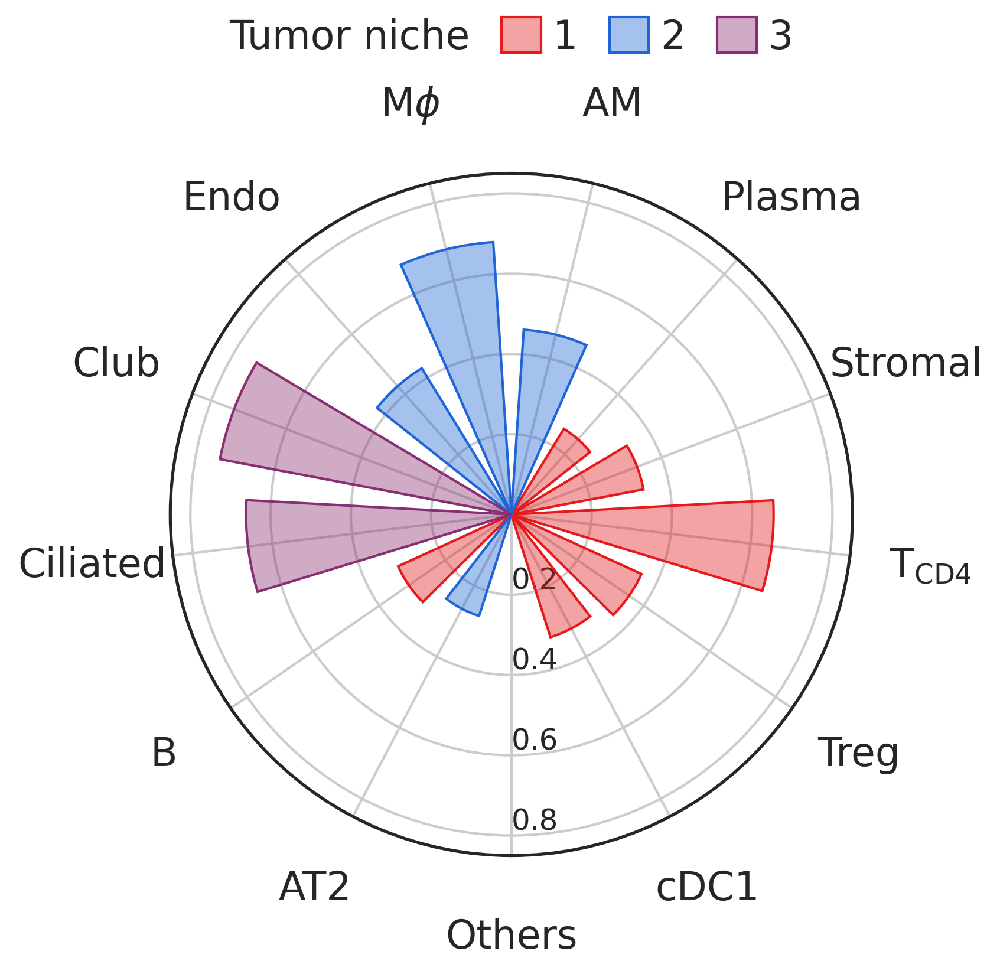

In [30]:
## representative cell niches: V radar plot
vdf_ = vdf.copy()
vdf_['niche2'] = vdf_['niche2'] / (sum(vdf_['niche2']**2)**0.5)
vdf_['niche3'] = vdf_['niche3'] / (sum(vdf_['niche3']**2)**0.5)
cts_reorder = ['Tumor cells', 'Alveolar cell type 2', 'B cell', 'Ciliated', 'Club', 
               'Endothelial cell', 'Macrophage', 'Macrophage alveolar',  
               'Plasma cell', 'Stromal', 'T cell CD4', 'T cell regulatory', 'cDC1']

vdf_reorder = vdf_.loc[cts_reorder]
xticklabels = ['Others']
for ct in cts_reorder[1:]:
    if ct in ct_name_dict:
        xticklabels.append(ct_name_dict[ct])
    else:
        xticklabels.append(ct)

comps = ['niche1', 'niche2', 'niche3']

draw_v_radar(vdf_reorder, comps, v_thres=0.2, colors=colors, alpha=0.8, width=0.35, offset=0.07, 
             xticklabels=xticklabels, rlabel_angle=0, figsize=(5,5), dpi=300, xtick_fs=16, xlabel_pad=20, 
             ylim=(0,0.85), yticks=[0.2,0.4,0.6,0.8], yticklabels=['0.2','0.4','0.6','0.8'], ytick_fs=12, 
             leg_loc='center', leg_pos=(0.5,1.2), leg_ncol=3, leg_title='Tumor niche', leg_fs=16, leg_title_fs=16, leg_title_left=True,
             title=None, title_fs=20, title_y=1.15)


## Niche score: spatial distribution
Spatial distribution of niche scores of tumor cell niche 1, 2 and 3.

In [26]:
def kde_diff(score_df, col, z_quantile=1, bw=20, nx=100, ny=100, lims=None, kernel=['gaussian', 'tophat']):
    
    assert col in score_df.columns, f'{col} not in score_df.columns!'
    x = score_df.x.values
    y = score_df.y.values
    z = score_df[col].values
    xy = np.vstack([x, y]).T # coordinates of points
    keep_ids = np.where(z <= np.quantile(z, z_quantile))[0]
    xy = xy[keep_ids,:]
    z = z[keep_ids]
    z = (z - z.min()) / (z.max() - z.min())

    kde1 = neighbors.KernelDensity(kernel=kernel, bandwidth=bw).fit(xy, sample_weight=z)
    kde0 = neighbors.KernelDensity(kernel=kernel, bandwidth=bw).fit(xy)
    
    xmin, xmax, ymin, ymax = lims
    xgrid, ygrid = np.mgrid[xmin:xmax:eval(f'{nx}j'), ymin:ymax:eval(f'{ny}j')]
    grid_coords = np.vstack([xgrid.ravel(), ygrid.ravel()]).T
    
    Z1 = kde1.score_samples(grid_coords)
    Z0 = kde0.score_samples(grid_coords)
    Z1 = np.reshape(np.exp(Z1), xgrid.shape)
    Z0 = np.reshape(np.exp(Z0), xgrid.shape)
    Z = Z1 - Z0
    Z = Z - Z.mean()
    
    return Z
    
def get_window_kde(crop, score_df, window, sigma=20, cutoff=0.05, kde_col=None):

    x0, y0, xl, yl = window
    window_lims = [x0, x0+xl, y0, y0+yl]
    crop_lims = [crop.obs.x.min(), crop.obs.x.max(), crop.obs.y.min(), crop.obs.y.max()]
    obs_df = sc.get.obs_df(crop, ['cell_id', 'x','y','cell_type'])
    target_df = score_df.loc[(score_df.x>x0)&(score_df.x<x0+xl)&(score_df.y>y0)&(score_df.y<y0+yl)]
    # target_df = target_df.sort_values(col).reset_index(drop=True)
    df0 = obs_df.loc[(obs_df.x>x0)&(obs_df.x<x0+xl)&(obs_df.y>y0)&(obs_df.y<y0+yl)]

    # kde
    K_target_window = cdist(target_df[['x', 'y']].values, df0[['x', 'y']].values)
    K_target_window = np.exp(-K_target_window**2/sigma**2)
    K_target_window[K_target_window < cutoff] = 0
    keep_niche_cell_ids = np.where(K_target_window.sum(0)>0)[0]
    niche_df = df0.reset_index(drop=True).iloc[keep_niche_cell_ids,:]
    if kde_col:
        z = kde_diff(target_df, col=kde_col, z_quantile=1, bw=15, nx=200, ny=200, lims=window_lims, kernel='gaussian')
    else:
        z = None
    
    return target_df, niche_df, z
    
def draw_window_kde(target_df, niche_df, col, window, z=None, draw_kde=False, window2=None,
                    crop=None, target_ct=None, draw_bg=False, bg_color='#F8F8F8', ms_bg=2,
                 niche_cts=None, niche_colors=None, bg_facecolor='#F8F8F8', 
                 cmap_im=mpl.colormaps['magma'], cmap_sca=mpl.colormaps['magma'],
                 ms_target=10, ms_niche=8, lw_target=0.4, lw_niche=0.6, alpha=1, 
                 ylabel=None, fs=16, title=None, figsize=(6, 6), dpi=300, add_frame=False,
                 leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=2, leg_mks=4):

    x0, y0, xl, yl = window
    window_lims = [x0, x0+xl, y0, y0+yl]
    
    ## niche ct
    if isinstance(niche_cts, str):
        niche_cts = [niche_cts]
    if isinstance(niche_colors, str):
        niche_colors = [niche_colors]

    ## draw
    sns.set_theme(style='white')
    fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
    if draw_bg:
        bg_df = crop[(crop.obs.x>x0)&(crop.obs.x<x0+xl)&(crop.obs.y>y0)&(crop.obs.y<y0+yl)&(crop.obs.cell_type!=target_ct)&(~crop.obs.cell_id.isin(niche_df.cell_id))].obs.copy()
        print(bg_df.shape)
        ax.scatter(bg_df['x'], bg_df['y'], ms_bg, facecolor=bg_color, edgecolor=bg_color, lw=0)
    if draw_kde:
        hist, bin_edges = np.histogram(z.flatten(), bins=50)
        im_lims = {'vmin': bin_edges[np.argmax(hist)+1], 'vmax': bin_edges[-1]}
        ax.imshow(np.rot90(z), cmap=cmap_im, extent=window_lims, **im_lims, aspect='auto')
    for (niche_ct, niche_color) in zip(niche_cts, niche_colors):
        niche_df_ = niche_df.loc[niche_df['cell_type']==niche_ct]
        ax.scatter(niche_df_['x'], niche_df_['y'], ms_niche, facecolors='None', alpha=alpha, edgecolor=niche_color, linewidth=lw_niche, label=niche_ct)
    sca_lims = {'vmin': 0, 'vmax': target_df[col].max()}
    ax.scatter(target_df['x'], target_df['y'], ms_target, target_df[col], edgecolor='#C0C0C0', lw=lw_target, cmap=cmap_sca, **sca_lims)
    ax.set_xlim([window_lims[0], window_lims[1]])
    ax.set_ylim([window_lims[2], window_lims[3]])
    ax.invert_yaxis()
    ax.set_xticks([])
    ax.set_yticks([])
    for s in ['top', 'bottom', 'right', 'left']:
        ax.spines[s].set_visible(False)
    ax.set_ylabel(ylabel, fontsize=fs)

    if window2 is not None:
        x20, y20, x2l, y2l = window2
        rect = mpatches.Rectangle((x20, y20), x2l, y2l, linewidth=4, linestyle='--', edgecolor='#0000CC', facecolor='none')
        ax.add_patch(rect)
    
    if add_frame:
        flw = 6
        rect = mpatches.Rectangle((window_lims[0], window_lims[2]), window_lims[1]-window_lims[0], window_lims[3]-window_lims[2], 
                                  linewidth=flw, linestyle='--', edgecolor='#000000', facecolor='none')
        ax.add_patch(rect)
    leg = ax.legend(bbox_to_anchor=leg_pos, loc=leg_loc, borderpad=0, borderaxespad=0, ncol=leg_ncol,
          framealpha=0, markerscale=leg_mks, fontsize=fs, handletextpad=0.2)
    for legobj in leg.legend_handles:
        legobj.set_linewidth(1.5)
    if not draw_kde:
        ax.set_facecolor(bg_facecolor)
    plt.show()

### Niche 1

In [29]:
cmap_niche_score = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche_score', ['#FFFFFF', cmap_niche(0)])

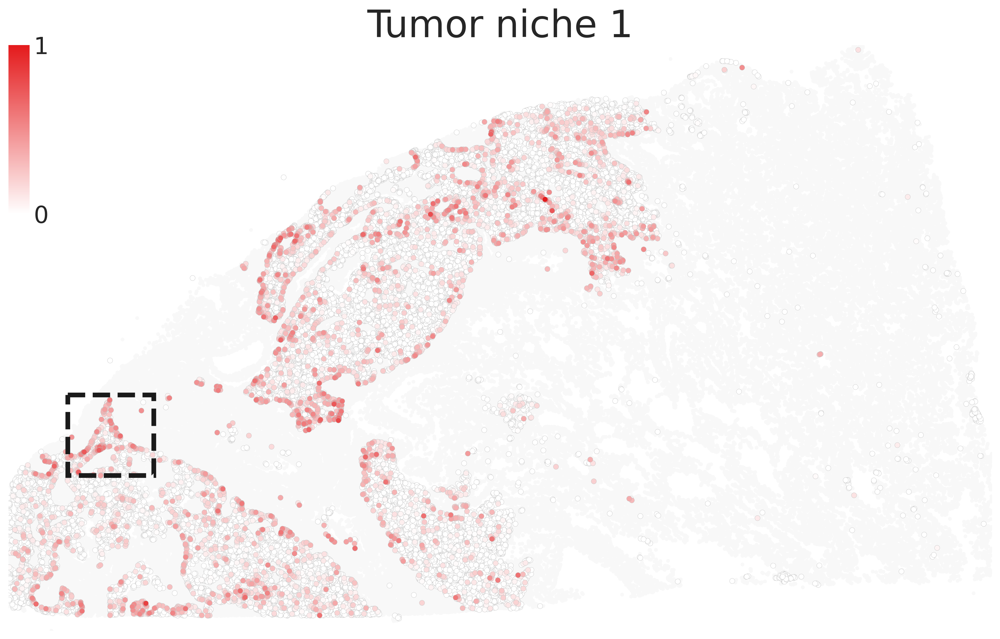

In [30]:
window = [700, 4500, 1000, 1000]
draw_niche_score_spatial(adata, score_df, 'S_niche1', target_ct='Tumor cells', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=20, lw=0.2, 
                         window=window, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel=None, ylabel_fs=24, title='Tumor niche 1', title_fs=32, 
                         show_colorbar=True, cb_label=None, cb_tick_fs=20, 
                         figsize=(15,9), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

In [31]:
## kde: window
comp = 'comp3'
col = 'S_niche1'
bg_facecolor = '#F8F8F8'
niche_cts = ['T cell CD4', 'T cell regulatory', 'Stromal', 'cDC1', 'B cell', 'Plasma cell']
print(f'Niche cell types: {niche_cts}.')
niche_colors = [ct_cmap_dict[k] for k in niche_cts]
target_df, niche_df, z = get_window_kde(adata, score_df, window, kde_col=col)

Niche cell types: ['T cell CD4', 'T cell regulatory', 'Stromal', 'cDC1', 'B cell', 'Plasma cell'].


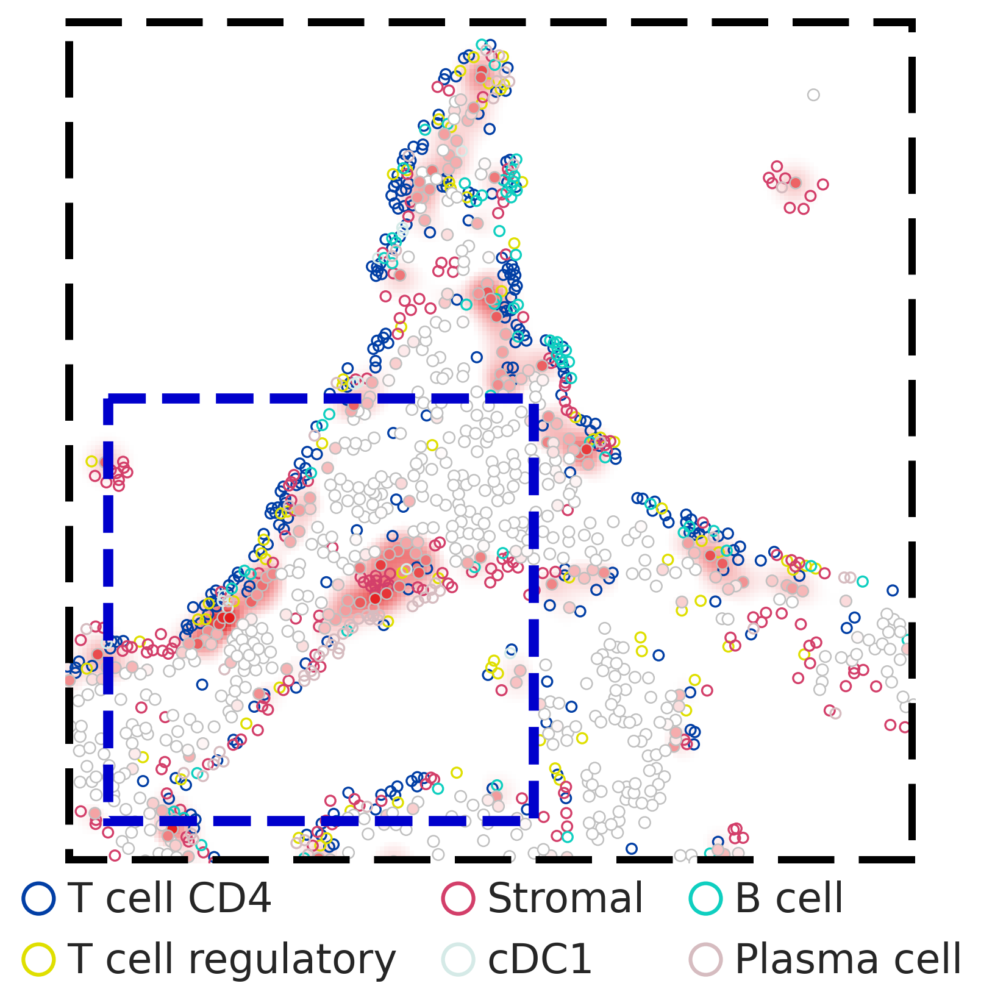

In [32]:
window2 = [750, 4950, 500, 500]
draw_window_kde(target_df, niche_df, col, window, z, draw_kde=True, window2=window2,
                crop=adata, target_ct='Tumor cells', draw_bg=False, bg_color='#F8F8F8', ms_bg=20,
                 niche_cts=niche_cts, niche_colors=niche_colors, bg_facecolor='#F8F8F8',
                 cmap_im=cmap_niche_score, cmap_sca=cmap_niche_score,
                 ms_target=20, ms_niche=16, lw_target=0.6, lw_niche=0.8, alpha=1, 
                 ylabel=None, fs=16, title=None, figsize=(6, 6), dpi=300, add_frame=True,
                 leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=3, leg_mks=3)

### Niche 2

In [11]:
cmap_niche_score = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche_score', ['#FFFFFF', cmap_niche(1)])

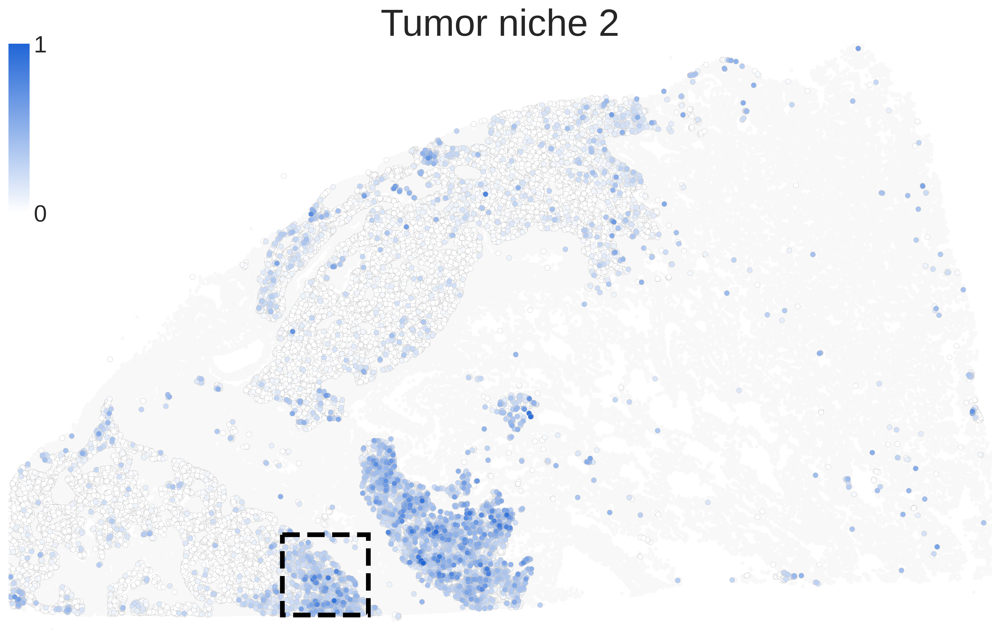

In [15]:
window = [3200, 6250, 1000, 1000]
draw_niche_score_spatial(adata, score_df, 'S_niche2', target_ct='Tumor cells', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=20, lw=0.2, 
                         window=window, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel=None, ylabel_fs=24, title='Tumor niche 2', title_fs=32, 
                         show_colorbar=True, cb_label=None, cb_tick_fs=20, 
                         figsize=(15,9), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

In [20]:
## kde: window
col = 'S_niche2'
bg_facecolor = '#F8F8F8'
niche_cts = ['Macrophage', 'Macrophage alveolar', 'Endothelial cell', 'Stromal']
print(f'Niche cell types: {niche_cts}.')
niche_colors = [ct_cmap_dict[k] for k in niche_cts]
target_df, niche_df, z = get_window_kde(adata, score_df, window, kde_col=col)

Niche cell types: ['Macrophage', 'Macrophage alveolar', 'Endothelial cell', 'Stromal'].


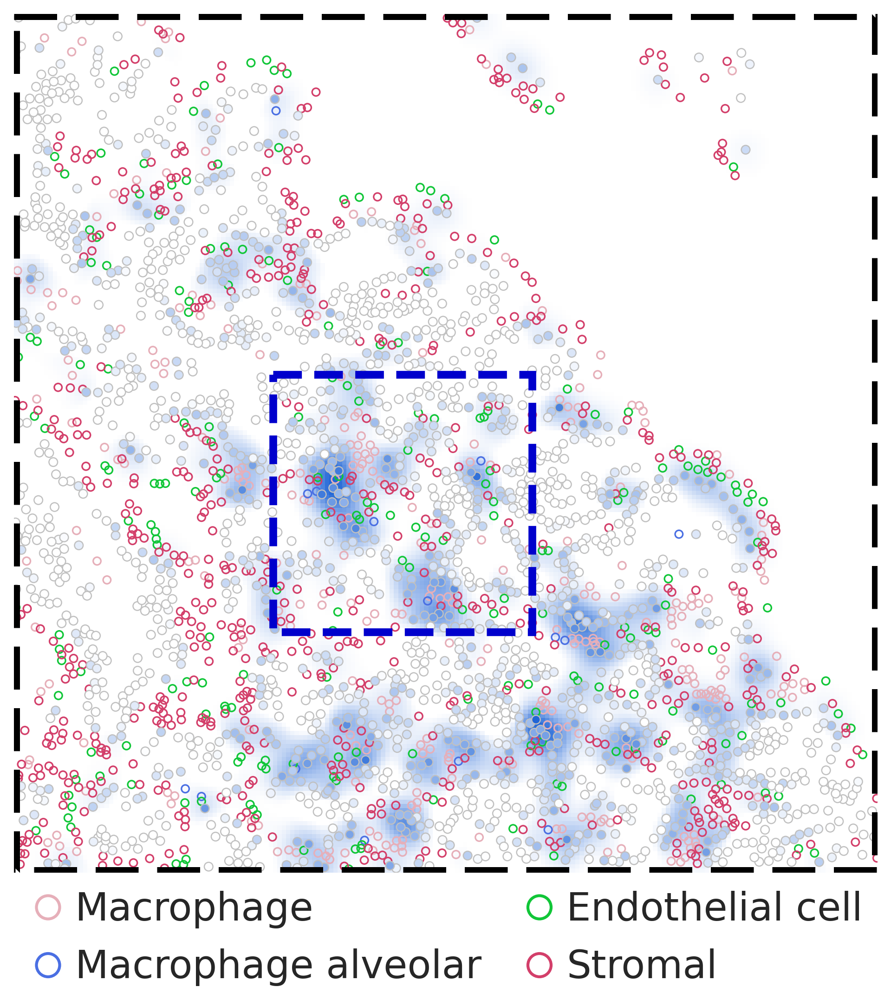

In [25]:
window2 = [3500, 6670, 300, 300]
draw_window_kde(target_df, niche_df, col, window, z, draw_kde=True, window2=window2,
                crop=adata, target_ct='Tumor cells', draw_bg=False, bg_color='#F8F8F8', ms_bg=20,
                 niche_cts=niche_cts, niche_colors=niche_colors, bg_facecolor='#F8F8F8',
                 cmap_im=cmap_niche_score, cmap_sca=cmap_niche_score,
                 ms_target=20, ms_niche=16, lw_target=0.6, lw_niche=0.8, alpha=1, 
                 ylabel=None, fs=20, title=None, figsize=(8, 8), dpi=300, add_frame=True,
                 leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=2, leg_mks=3)

### Niche 3

In [34]:
cmap_niche_score = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche_score', ['#FFFFFF', cmap_niche(2)])

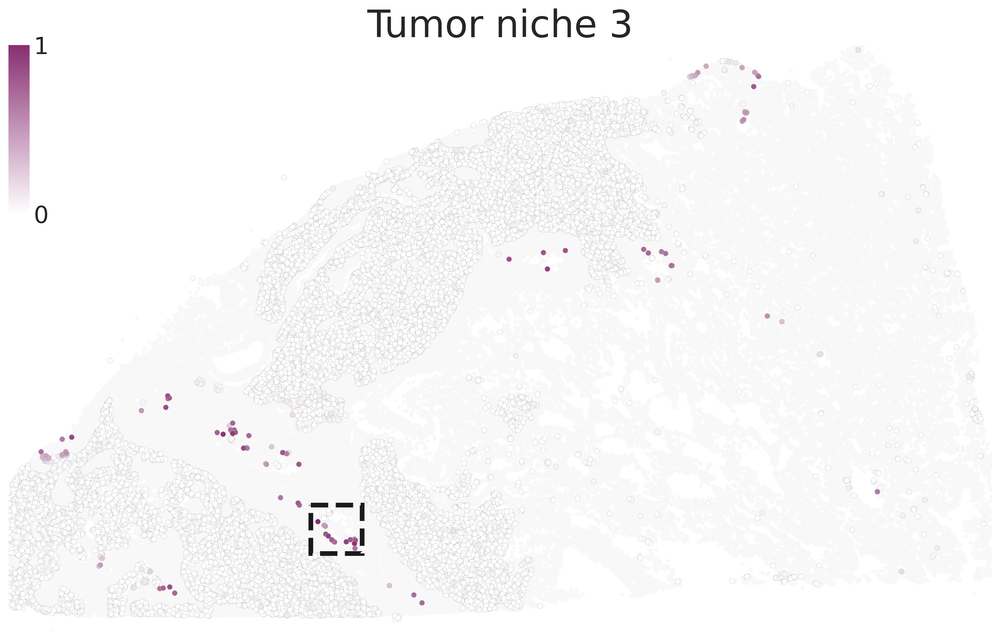

In [35]:
window = [3530, 5870, 600, 600]
draw_niche_score_spatial(adata, score_df, 'S_niche3', target_ct='Tumor cells', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=20, lw=0.2, 
                         window=window, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel=None, ylabel_fs=24, title='Tumor niche 3', title_fs=32, 
                         show_colorbar=True, cb_label=None, cb_tick_fs=20, 
                         figsize=(15,9), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

In [36]:
## kde: window
col = 'S_niche3'
bg_facecolor = '#F8F8F8'
niche_cts = ['Club', 'Ciliated', 'Mast cell']
print(f'Niche cell types: {niche_cts}.')
niche_colors = [ct_cmap_dict[k] for k in niche_cts]
target_df, niche_df, z = get_window_kde(adata, score_df, window, kde_col=col)

Niche cell types: ['Club', 'Ciliated', 'Mast cell'].


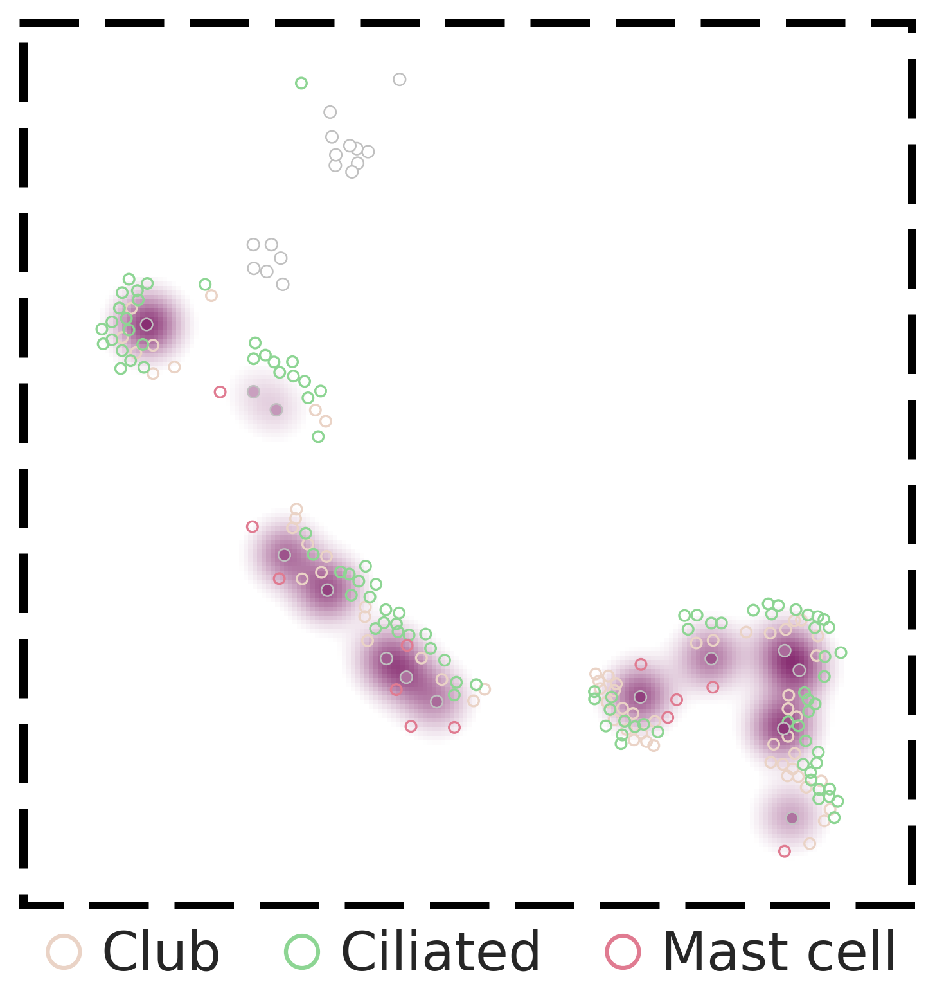

In [38]:
window2 = None
draw_window_kde(target_df, niche_df, col, window, z, draw_kde=True, window2=window2,
                crop=adata, target_ct='Tumor cells', draw_bg=False, bg_color='#F8F8F8', ms_bg=20,
                 niche_cts=niche_cts, niche_colors=niche_colors, bg_facecolor='#F8F8F8',
                 cmap_im=cmap_niche_score, cmap_sca=cmap_niche_score,
                 ms_target=20, ms_niche=16, lw_target=0.6, lw_niche=0.8, alpha=1, 
                 ylabel=None, fs=20, title=None, figsize=(6, 6), dpi=300, add_frame=True,
                 leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=3, leg_mks=3)

## Niche genes
Combined gene coefficients of tumor cell niche 1, 2 and 3.

### Top niche genes

In [39]:
combine = []
u_thres = 0.05
n_top = 20
columns = ['niche1', 'niche2', 'niche3']
for column in columns:
    tmp = udf.loc[udf[column]>=u_thres].sort_values(column, ascending=False)[columns]
    tmp = tmp.head(n_top)
    combine.append(tmp)
    print(tmp.shape)
combine = pd.concat(combine, axis=0)
combine = combine[~combine.index.duplicated(keep='first')]
combine.shape

(20, 3)
(20, 3)
(20, 3)


(60, 3)

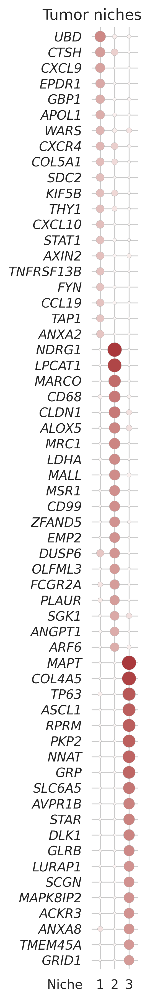

In [42]:
plt.rcParams.update({"figure.dpi": 300})
sns.set_theme(style="whitegrid")
sns.set_context('paper',font_scale=1.)
ucolor_df = combine.stack().reset_index(name="u")
w = 2
h = 0.2*len(combine)
asp = w/h
csm = ucolor_df.u.max()
fs = 11
mx = 0.3
my = 0.01
leg_pos = (1.1, 0.95)
sizes = (5, 150)
g = sns.relplot(
    data=ucolor_df, 
    x="level_1", y="level_0", hue="u", size="u",
    palette="vlag", hue_norm=(-csm, csm), edgecolor=".7",
    height=h, aspect=asp, sizes=sizes, size_norm=(0, csm), legend=True, 
)
g.set(xlabel="", ylabel="", xticklabels='', title=None)

g.set_xticklabels([1,2,3], size = fs, rotation=0)
g.set_yticklabels(size = fs, style='italic')
g.despine(left=True, bottom=True)
g.ax.margins(x=mx, y=my)
g.ax.text(-1.2, len(combine)+0.2, 'Niche', fontsize=fs, ha='right', va='top')
g.ax.text(-4, -1.8, 'Tumor niches', fontsize=fs+2, ha='left', va='top')
g._legend.remove()


## Pathways

In [43]:
enr_u_thres = 0.05
enr_n_top = 100
gene_sets = ['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2025','Reactome_2022']

print('Number of niche genes used for pathway enrichment analysis:')

## niche 1
comp = 'niche1'
glist = udf.loc[udf[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 1: {len(glist)} genes')
enr1 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
## niche 2
comp = 'niche2'
glist = udf.loc[udf[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 2: {len(glist)} genes')
enr2 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
## niche 3
comp = 'niche3'
glist = udf.loc[udf[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 3: {len(glist)} genes')
enr3 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)

Number of niche genes used for pathway enrichment analysis:
Niche 1: 84 genes
Niche 2: 100 genes
Niche 3: 100 genes


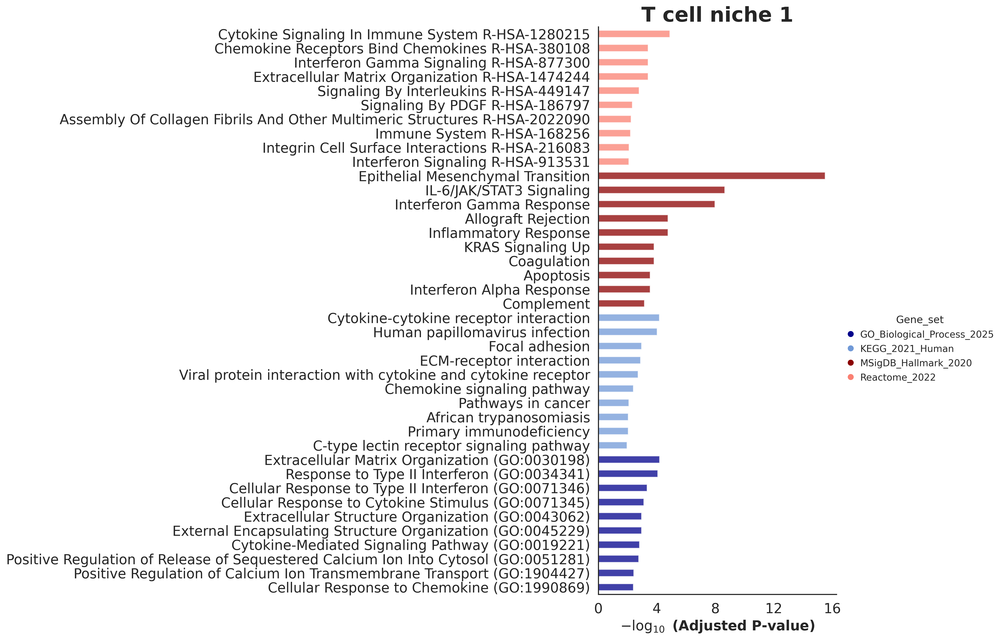

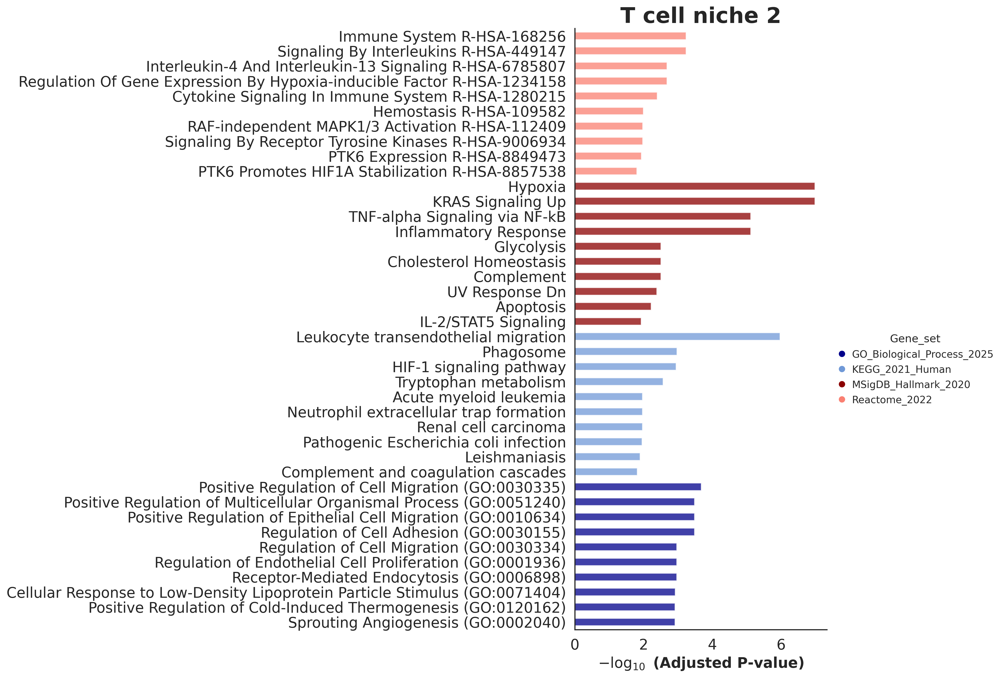

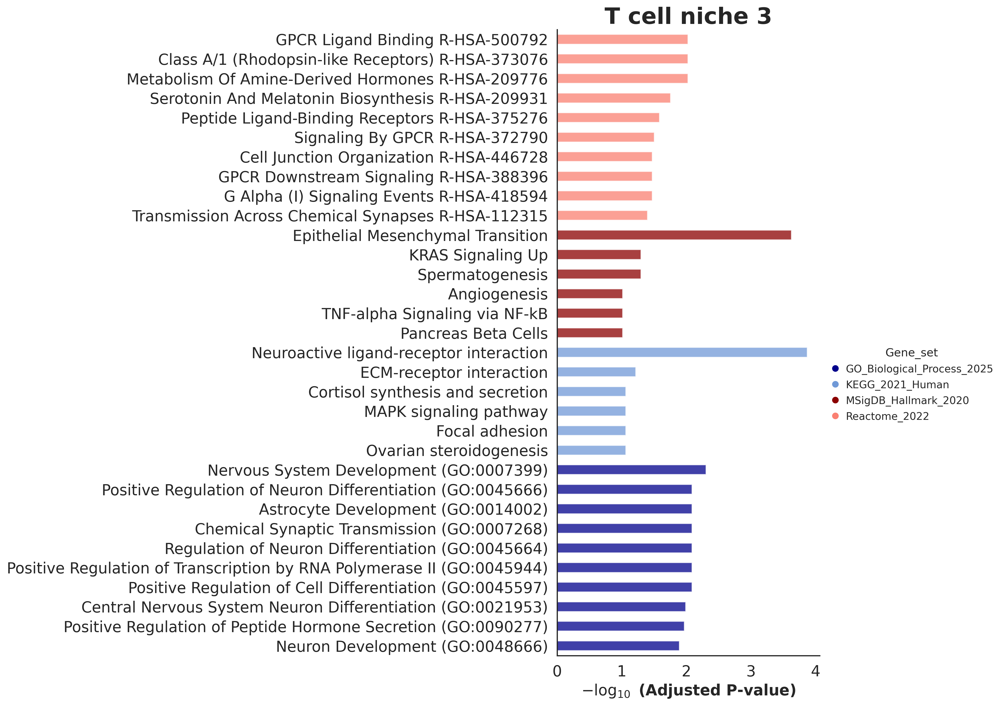

In [45]:
sns.set_theme(style='white')
for i, enr in enumerate([enr1, enr2, enr3]):
    with mpl.rc_context({'figure.dpi': 300}):
        gseapy.barplot(enr.results,
                       title=f"T cell niche {i+1}",
                       cutoff=0.1,
                       column="Adjusted P-value",
                       group='Gene_set', 
                       size=10,
                       top_term=10,
                       figsize=(5,12),
                       color=['darkblue','#7099d7','darkred','salmon'] 
                      )

## Pseudotime

In [50]:
def draw_pseudotime(score_col, ptime_col='tumor_pseudotime_rank_Lineage1', nbar=50, lam=1e-4,
                   lw=3, color='C3', label_fs=20, tick_fs=16, figsize=(5,3), dpi=300, save=None, transparent=True):
    ts = np.linspace(0, 1, nbar)
    t0s, t1s = ts[:-1], ts[1:]
    mean_score = []
    for (t0, t1) in zip(t0s, t1s):
        mean_score.append(np.mean(ptime_score.loc[(ptime_score[ptime_col]>=t0)&(ptime_score[ptime_col]<t1), score_col]))
    mean_score = np.array(mean_score)

    fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
    x = ts[:-1]+0.5/nbar
    y = mean_score
    xnew = np.linspace(0, 1, 200)
    spl = make_smoothing_spline(x, y, lam=lam)
    ynew = spl(xnew)
    ax.plot(xnew, ynew, lw=lw, color=color, ls='dashdot')
    ax.set_yticks([])
    ax.set_xticks([])
    ax.set_ylabel('Mean score', fontsize=label_fs)
    ax.set_xlabel('Pseudotime', fontsize=label_fs)
    ax.tick_params(axis='both', which='major', labelsize=tick_fs)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    if save is not None:
        plt.savefig(save, transparent=transparent)
    plt.show()

In [48]:
## pseudotime
ptime = pd.read_csv(f'{xenium_res_dir}/tumor_pseudotime_res0.1.csv', sep='\t')
ptime = ptime.iloc[:,1:]
ptime_score = pd.merge(ptime[['cell_id', 'tumor_pseudotime_Lineage1', 'tumor_pseudotime_rank_Lineage1']], score_df.copy(), on='cell_id', how='inner')
print(ptime_score.shape)

(28891, 539)


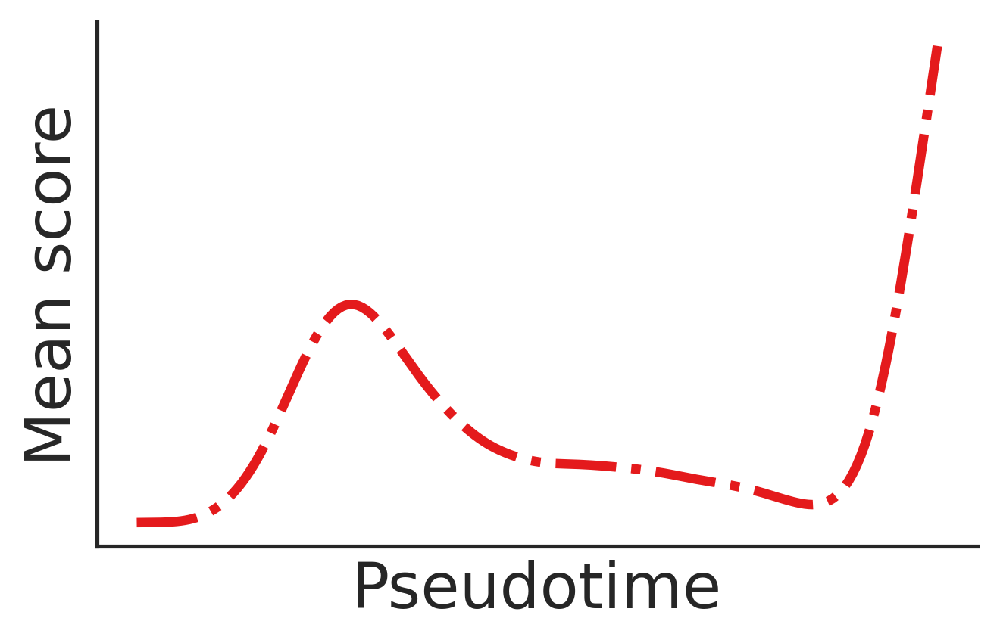

In [52]:
## niche 1
draw_pseudotime('S_niche1', color=cmap_niche(0), save=None)

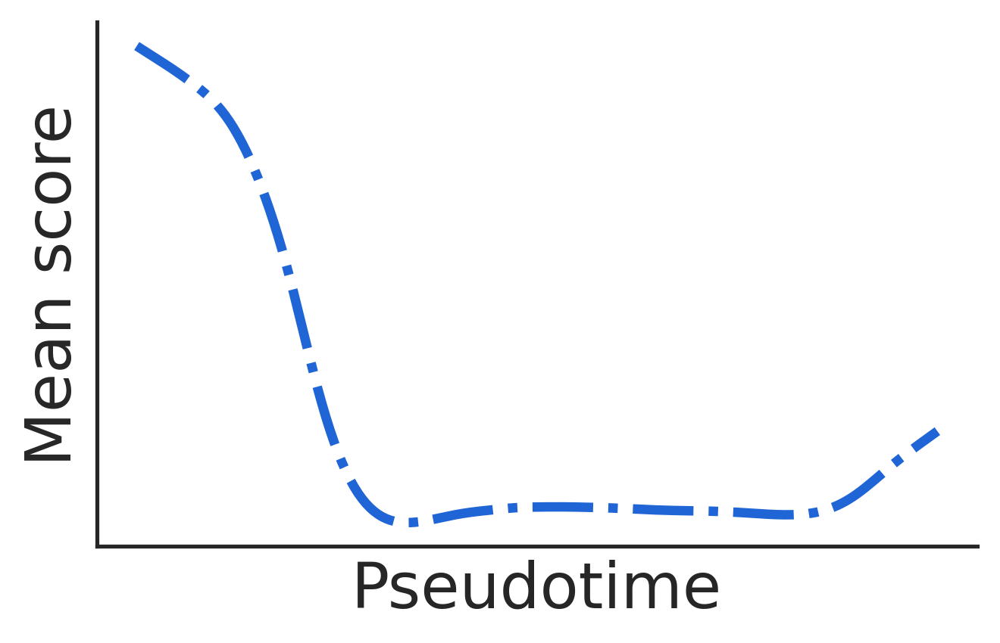

In [53]:
## niche 2
draw_pseudotime('S_niche2', color=cmap_niche(1), save=None)

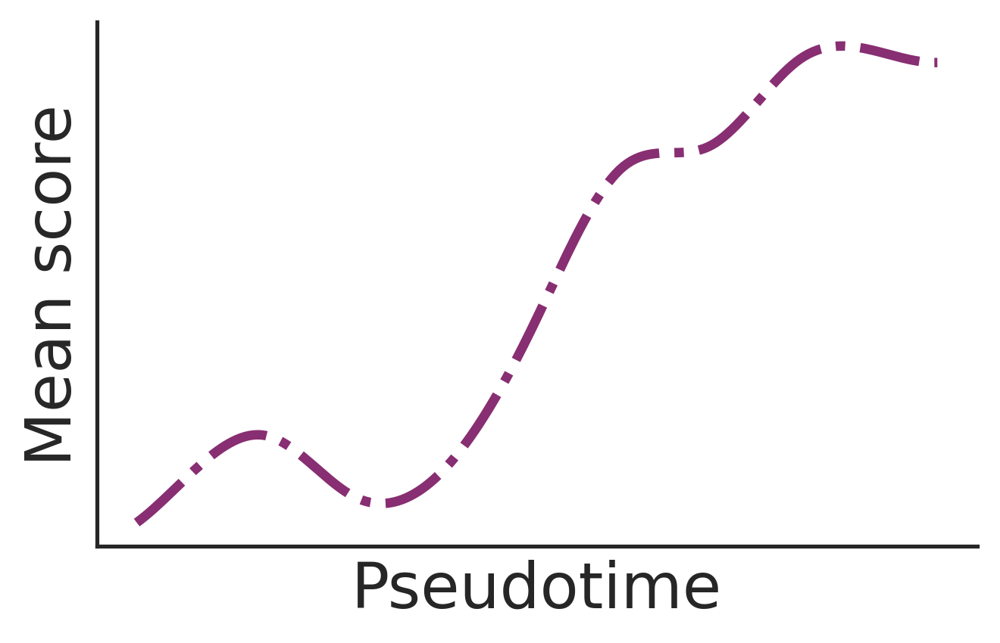

In [55]:
## niche 3
draw_pseudotime('S_niche3', nbar=10, color=cmap_niche(2), save=None)

## Survival analysis
Evaluate clinical relevance of niche-like cell types using TCGA-LUAD bulk RNA-seq and clinical information.

In [66]:
tcga_data_dir = '../data/TCGA-LUAD'
surv_res_dir = '../results/survival'
clinic_vars = ['case_submitter_id', 'status', 'months_to_follow_up']

In [82]:
## tcga bulk rna and clinic info
count = pd.read_csv(f'{tcga_data_dir}/surv_expr_xenium_genes.csv', sep='\t')
clinic = pd.read_csv(f'{tcga_data_dir}/clinical.tsv', sep='\t')
clinic = clinic.drop_duplicates('case_submitter_id').reset_index(drop=True)
follow = pd.read_csv(f'{tcga_data_dir}/follow_up.tsv', sep='\t')
follow = follow.loc[follow.timepoint_category=='Last Contact'].drop_duplicates('case_submitter_id').reset_index(drop=True)
surv_data = pd.merge(clinic, follow[['case_submitter_id', 'days_to_follow_up']], how='inner')
surv_data['status'] = surv_data['vital_status'].map({'Alive': False, 'Dead': True})
surv_data['days_to_follow_up'] = surv_data['days_to_follow_up'].astype(int)
surv_data['months_to_follow_up'] = (surv_data['days_to_follow_up']/30).astype(int)

In [364]:
def draw_surv_curve2(surv_prop, cond_cols, texts=None, text_pos=None, leg_titles=None, leg_pos=(0.05,0.02),
                    colors=['C3', 'darkblue'], labels=None, linestyle='solid',
                    tick_fs=12, label_fs=14, leg_fs=12, text_fs=12, figsize=(5,4), dpi=300):

    conds = ['high', 'low']
    df = surv_prop.copy()
    sns.set_style('white')
    fig, ax = plt.subplots(1, 2, figsize=figsize, dpi=dpi)
    for i, (cond_col, label) in enumerate(zip(cond_cols, labels)):
        thres = np.quantile(df[cond_col], 0.5)
        for cd, cl, lb in zip(conds, colors, label):
            if cd == 'high':
                mask = df[cond_col]>thres
            else:
                mask = df[cond_col]<=thres
            time, surv, conf = kaplan_meier_estimator(
                df.loc[mask, "status"], 
                df.loc[mask, "months_to_follow_up"], 
                conf_type="log-log"
            )
            ax[i].step(time, surv, where="post", label=lb, color=cl, lw=1.5, linestyle=linestyle)
        ax[i].set_ylim(-0.05, 1.05)
        ax[i].set_xlim(-5, 155)
        ax[i].set_xticks(np.arange(0,155,50))
        if i == 0:
            ax[i].set_yticks([0,0.25,0.5,0.75,1])
            ax[i].set_ylabel(r"Survival probability", fontsize=label_fs, labelpad=5)
        else:
            ax[i].set_yticks([])
        ax[i].tick_params(axis='both', which='major', labelsize=tick_fs)
        ax[i].spines['top'].set_visible(False)
        ax[i].spines['right'].set_visible(False)
        leg = ax[i].legend(bbox_to_anchor=leg_pos, loc="lower left", fontsize=leg_fs, title_fontsize=leg_fs, title=leg_titles[i], alignment='left', ncol=1)
        ax[i].text(text_pos[0], text_pos[1], texts[i], ha='right', va='top', fontsize=text_fs)
    fig.supxlabel("Months to last follow up/death", x=0.5, y=-0.02, fontsize=label_fs)
    plt.subplots_adjust(wspace=0.1)
    plt.show()

### Random niche-like tumor cell

In [341]:
ct = 'Tumor cells'
ct1, ct2 = f'Random niche-like {ct}', f'Other {ct}'
new_ct_col = 'cell_type_random_niche'
np.random.seed(2)
score_df[new_ct_col] = ct2
random_niche_cell_ids = np.random.choice(score_df['cell_id'].tolist(), size=int(len(score_df)*0.2))
score_df.loc[score_df['cell_id'].isin(random_niche_cell_ids), new_ct_col] = ct1
obs = adata.obs.copy()
obs[new_ct_col] = obs['cell_type'].copy().astype(str)
obs.loc[obs['cell_type']==ct, new_ct_col] = score_df[new_ct_col].values
print(f"{ct1}: {len(obs.loc[obs[new_ct_col]==ct1])}")
print(f"{ct2}: {len(obs.loc[obs[new_ct_col]==ct2])}")
adata_surv = adata.copy()
adata_surv.obs = obs
adata_surv.write(f'{surv_res_dir}/random_niche_tumor.h5ad')

Random niche-like Tumor cells: 5253
Other Tumor cells: 23638


In [342]:
command = f"python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py \
            --cell_class_column cell_type_random_niche \
            --tissue random_niche_tumor \
            --out_dir {surv_res_dir} \
            --ST_Data {tcga_data_dir}/surv_expr_xenium_genes.h5ad \
            --SC_Data {surv_res_dir}/random_niche_tumor.h5ad \
            --Only_InitProp \
            --n_max_cells 50000"
print(command)

python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py             --cell_class_column cell_type_random_niche             --tissue random_niche_tumor_seed2             --out_dir ../results/survival             --ST_Data ../data/TCGA-LUAD/surv_expr_xenium_genes.h5ad             --SC_Data ../results/survival/random_niche_tumor_seed2.h5ad             --Only_InitProp             --n_max_cells 50000


In [343]:
os.system(command)

2025-08-04 01:02:52,971	INFO worker.py:1518 -- Started a local Ray instance.


2025-08-04 01:03:28,928 : INFO : A single ST data with spatial location shape: (507, 2)
2025-08-04 01:03:30,196 : INFO : Begin: process_cell_type_info
2025-08-04 01:03:30,196 : INFO : process_cell_type_info: number of cells in reference: 171923
2025-08-04 01:03:30,196 : INFO : process_cell_type_info: number of genes in reference: 5001
2025-08-04 01:03:30,197 : INFO : cell_type_random_niche       
Stromal                          42170
Endothelial cell                 27497
Other Tumor cells                23638
T cell CD4                       14273
Macrophage                       11168
Alveolar cell type 1              7599
Alveolar cell type 2              5900
B cell                            5856
Ciliated                          5716
Random niche-like Tumor cells     5253
Plasma cell                       4895
T cell regulatory                 4827
Mast cell                         2167
T cell CD8                        2146
Club                              2037
Macrophage alve

0

In [344]:
## save props
ct = 'Tumor cells'
ct1, ct2 = f'Random niche-like {ct}', f'Other {ct}'
count = pd.read_csv(f'{tcga_data_dir}/surv_expr_xenium_genes.csv', sep='\t')
with open(f'{surv_res_dir}/random_niche_tumor/InitProp.pickle', 'rb') as f:
    res1 = pickle.load(f)
prop1 = res1['results']
prop1 = pd.DataFrame(prop1.values / prop1.values.sum(1)[:,None], columns=prop1.columns)
print(prop1.shape)
prop1_withid = prop1.copy()
prop1_withid['case_submitter_id'] = count['case_submitter_id']
prop1_withid.to_csv(f'{surv_res_dir}/random_niche_tumor/prop.csv', sep='\t', index=False)

(507, 22)


### Niche 1-like tumor cell

In [75]:
ct = 'Tumor cells'
score_col = f'S_niche1'
new_ct_col = f'cell_type_niche1'
score_df[new_ct_col] = score_df[score_col].apply(lambda x: f'Niche 1-like {ct}' if x > 0 else f'Other {ct}')
obs = adata.obs.copy()
obs[new_ct_col] = obs['cell_type'].copy().astype(str)
obs.loc[obs['cell_type']==ct, new_ct_col] = score_df[new_ct_col].values
adata_surv = adata.copy()
adata_surv.obs = obs
print(f"Niche 1-like {ct}: {len(obs.loc[obs[new_ct_col]==f'Niche 1-like {ct}'])}")
print(f"Other {ct}: {len(obs.loc[obs[new_ct_col]==f'Other {ct}'])}")
adata_surv.write(f'{surv_res_dir}/niche1_tumor.h5ad')

Niche 1-like Tumor cells: 5130
Other Tumor cells: 23761


In [91]:
command = f"python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py \
            --cell_class_column cell_type_niche1 \
            --tissue niche1_tumor \
            --out_dir {surv_res_dir} \
            --ST_Data {tcga_data_dir}/surv_expr_xenium_genes.h5ad \
            --SC_Data {surv_res_dir}/niche1_tumor.h5ad \
            --Only_InitProp \
            --n_max_cells 50000"
print(command)

python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py             --cell_class_column cell_type_niche1             --tissue niche1_tumor             --out_dir ../results/survival             --ST_Data ../data/TCGA-LUAD/surv_expr_xenium_genes.h5ad             --SC_Data ../results/survival/niche1_tumor.h5ad             --Only_InitProp             --n_max_cells 50000


In [92]:
os.system(command)

2025-08-03 10:55:03,930	INFO worker.py:1518 -- Started a local Ray instance.


2025-08-03 10:55:16,805 : INFO : A single ST data with spatial location shape: (507, 2)
2025-08-03 10:55:18,071 : INFO : Begin: process_cell_type_info
2025-08-03 10:55:18,071 : INFO : process_cell_type_info: number of cells in reference: 171923
2025-08-03 10:55:18,071 : INFO : process_cell_type_info: number of genes in reference: 5001
2025-08-03 10:55:18,072 : INFO : cell_type_niche1        
Stromal                     42170
Endothelial cell            27497
Other Tumor cells           23761
T cell CD4                  14273
Macrophage                  11168
Alveolar cell type 1         7599
Alveolar cell type 2         5900
B cell                       5856
Ciliated                     5716
Niche 1-like Tumor cells     5130
Plasma cell                  4895
T cell regulatory            4827
Mast cell                    2167
T cell CD8                   2146
Club                         2037
Macrophage alveolar          2016
Monocyte                     1583
cDC2                       

0

In [ ]:
## save props
ct = 'Tumor cells'
ct1, ct2 = f'Niche 1-like {ct}', f'Other {ct}'
count = pd.read_csv(f'{tcga_data_dir}/surv_expr_xenium_genes.csv', sep='\t')
with open(f'{surv_res_dir}/niche1_tumor/InitProp.pickle', 'rb') as f:
    res1 = pickle.load(f)
prop1 = res1['results']
prop1 = pd.DataFrame(prop1.values / prop1.values.sum(1)[:,None], columns=prop1.columns)
print(prop1.shape)
prop1_withid = prop1.copy()
prop1_withid['case_submitter_id'] = count['case_submitter_id']
prop1_withid.to_csv(f'{surv_res_dir}/niche1_tumor/prop.csv', sep='\t', index=False)

In [347]:
## load props
ct = 'Tumor cells'
ct_ = ct.replace(' ', '_')
kde_comp = 3
ct1, ct2, ct01, ct02 = f'Niche 1-like {ct}', f'Other {ct}', f'Random niche-like {ct}', f'Other {ct}'
prop0_withid = pd.read_csv(f'{surv_res_dir}/random_niche_tumor/prop.csv', sep='\t')
prop1_withid = pd.read_csv(f'{surv_res_dir}/niche1_tumor/prop.csv', sep='\t')
prop0_withid[f'{ct1} random prop'] = prop0_withid[ct01] / (prop0_withid[ct01] + prop0_withid[ct02])
prop1_withid[f'{ct1} prop'] = prop1_withid[ct1] / (prop1_withid[ct1] + prop1_withid[ct2])
surv_prop = pd.merge(surv_data[clinic_vars], prop0_withid[['case_submitter_id', f'{ct1} random prop']], on='case_submitter_id', how='inner')
surv_prop = pd.merge(surv_prop, prop1_withid[['case_submitter_id', f'{ct1} prop']], on='case_submitter_id', how='inner')

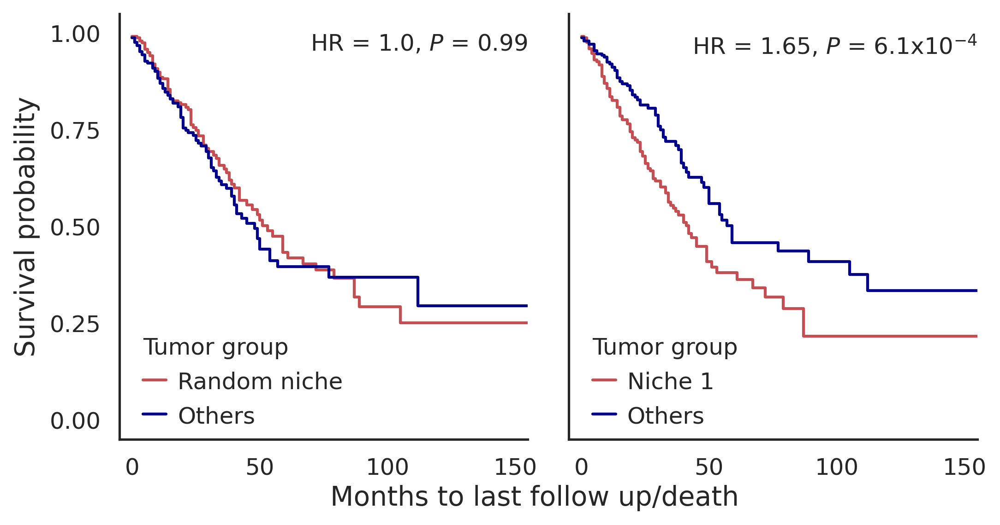

In [348]:
draw_surv_curve2(surv_prop, [f'{ct1} random prop', f'{ct1} prop'], texts=['HR = 1.0, $P$ = 0.99', 'HR = 1.65, $P$ = 6.1x$10^{-4}$'], text_pos=[155, 1],
                 leg_pos=(0.03,0.0), leg_titles=['Tumor group', 'Tumor group'], labels=[['Random niche', 'Others'], ['Niche 1', 'Others']], figsize=(8,4))


### Niche 1-like Treg

In [241]:
niche_id = 1
ct = 'T cell regulatory'
ct1, ct2 = f'Niche {niche_id}-like {ct}', f'Other {ct}'
ct_name = 'Treg'

score_col = f'S_niche1'
new_ct_col = f'cell_type_niche1'
sigma = 20
cutoff = 0.05
obs = adata.obs.copy()
loc_target_in_niche = score_df.loc[score_df[score_col]>0][['cell_id', 'x', 'y']] # niche 1 region
loc_ct = obs.loc[obs['cell_type']==ct, ['cell_id', 'x', 'y']]
K = cdist(loc_target_in_niche.iloc[:,1:], loc_ct.iloc[:,1:])
K = np.exp(-K**2/sigma**2)
ct_ids = loc_ct.index.values
ct_in_niche_ids = ct_ids[np.where(K.max(0)>cutoff)[0]]
ct_others_ids = ct_ids[np.where(K.max(0)<=cutoff)[0]]
loc_ct[new_ct_col] = ct2
loc_ct.loc[ct_in_niche_ids, new_ct_col] = ct1

obs = adata.obs.copy()
obs[new_ct_col] = obs['cell_type'].copy().astype(str)
obs.loc[obs['cell_type']==ct, new_ct_col] = loc_ct[new_ct_col].values
print(f"{ct1}: {len(obs.loc[obs[new_ct_col]==ct1])}")
print(f"{ct2}: {len(obs.loc[obs[new_ct_col]==ct2])}")

adata_surv = adata.copy()
adata_surv.obs = obs
adata_surv.write(f'{surv_res_dir}/niche{niche_id}_Treg.h5ad')

0.0
Niche 1-like T cell regulatory: 1707
Other T cell regulatory: 3120


In [242]:
command = f"python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py \
            --cell_class_column cell_type_niche{niche_id} \
            --tissue niche{niche_id}_{ct_name} \
            --out_dir {surv_res_dir} \
            --ST_Data {tcga_data_dir}/surv_expr_xenium_genes.h5ad \
            --SC_Data {surv_res_dir}/niche{niche_id}_{ct_name}.h5ad \
            --Only_InitProp \
            --n_max_cells 50000"
print(command)

python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py             --cell_class_column cell_type_niche1             --tissue niche1_Treg             --out_dir ../results/survival             --ST_Data ../data/TCGA-LUAD/surv_expr_xenium_genes.h5ad             --SC_Data ../results/survival/niche1_Treg.h5ad             --Only_InitProp             --n_max_cells 50000


In [243]:
os.system(command)

2025-08-03 22:06:19,080	INFO worker.py:1518 -- Started a local Ray instance.


2025-08-03 22:06:54,685 : INFO : A single ST data with spatial location shape: (507, 2)
2025-08-03 22:06:55,992 : INFO : Begin: process_cell_type_info
2025-08-03 22:06:55,992 : INFO : process_cell_type_info: number of cells in reference: 171923
2025-08-03 22:06:55,992 : INFO : process_cell_type_info: number of genes in reference: 5001
2025-08-03 22:06:55,993 : INFO : cell_type_niche1              
Stromal                           42170
Tumor cells                       28891
Endothelial cell                  27497
T cell CD4                        14273
Macrophage                        11168
Alveolar cell type 1               7599
Alveolar cell type 2               5900
B cell                             5856
Ciliated                           5716
Plasma cell                        4895
Other T cell regulatory            3120
Mast cell                          2167
T cell CD8                         2146
Club                               2037
Macrophage alveolar                2016

0

In [ ]:
## save props
niche_id = 1
ct = 'T cell regulatory'
ct1, ct2 = f'Niche {niche_id}-like {ct}', f'Other {ct}'
ct_name = 'Treg'
with open(f'{surv_res_dir}/niche{niche_id}_{ct_name}/InitProp.pickle', 'rb') as f:
    res1 = pickle.load(f)
prop1 = res1['results']
prop1 = pd.DataFrame(prop1.values / prop1.values.sum(1)[:,None], columns=prop1.columns)
print(prop1.shape)
prop1_withid = prop1.copy()
prop1_withid['case_submitter_id'] = count['case_submitter_id']
prop1_withid.to_csv(f'{surv_res_dir}/niche{niche_id}_{ct_name}/prop.csv', sep='\t', index=False)

In [359]:
## load props
niche_id = 1
ct = 'T cell regulatory'
ct1, ct2 = f'Niche {niche_id}-like {ct}', f'Other {ct}'
prop1_withid = pd.read_csv(f'{surv_res_dir}/niche1_Treg/prop.csv', sep='\t')
prop1_withid[f'{ct1} prop'] = prop1_withid[ct1] / (prop1_withid[ct1] + prop1_withid[ct2])
surv_prop = pd.merge(surv_data[clinic_vars], prop1_withid, on='case_submitter_id', how='inner')
surv_prop[ct] = surv_prop[ct1] + surv_prop[ct2]
surv_prop[f'{ct1} prop'] = surv_prop[ct1] / surv_prop[ct]
surv_prop[f'{ct2} prop'] = surv_prop[ct2] / surv_prop[ct]
surv_prop = surv_prop.loc[surv_prop[ct]>0]
print(len(surv_prop))

505


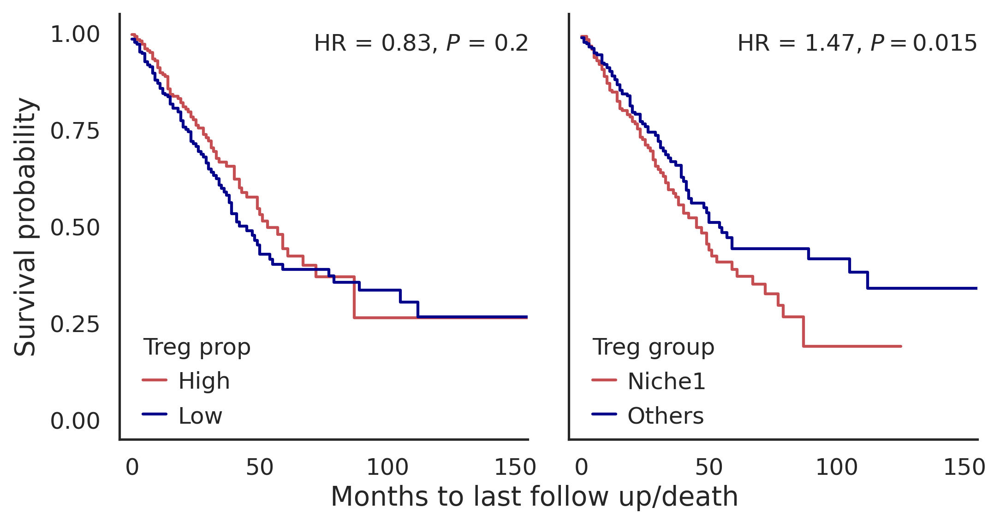

In [360]:
draw_surv_curve2(surv_prop, [ct, f'{ct1} prop'], texts=['HR = 0.83, $P$ = 0.2', 'HR = 1.47, $P = 0.015$'], text_pos=[155, 1],
                 leg_pos=(0.03,0.0), leg_titles=['Treg prop', 'Treg group'], labels=[['High', 'Low'], ['Niche1', 'Others']], figsize=(8,4))

### Niche 2-like macrophage

In [246]:
niche_id = 2
ct = 'Macrophage'
ct1, ct2 = f'Niche {niche_id}-like {ct}', f'Other {ct}'
ct_name = 'macrophage'
score_col = f'S_niche{niche_id}'
new_ct_col = f'cell_type_niche{niche_id}'
sigma = 20
cutoff = 0.05
obs = adata.obs.copy()
loc_target_in_niche = score_df.loc[score_df[score_col]>0][['cell_id', 'x', 'y']] # niche 2 region
loc_ct = obs.loc[obs['cell_type']==ct, ['cell_id', 'x', 'y']]
K = cdist(loc_target_in_niche.iloc[:,1:], loc_ct.iloc[:,1:])
K = np.exp(-K**2/sigma**2)
ct_ids = loc_ct.index.values
ct_in_niche_ids = ct_ids[np.where(K.max(0)>cutoff)[0]]
ct_others_ids = ct_ids[np.where(K.max(0)<=cutoff)[0]]
loc_ct[new_ct_col] = ct2
loc_ct.loc[ct_in_niche_ids, new_ct_col] = ct1

obs = adata.obs.copy()
obs[new_ct_col] = obs['cell_type'].copy().astype(str)
obs.loc[obs['cell_type']==ct, new_ct_col] = loc_ct[new_ct_col].values
print(f"{ct1}: {len(obs.loc[obs[new_ct_col]==ct1])}")
print(f"{ct2}: {len(obs.loc[obs[new_ct_col]==ct2])}")

adata_surv = adata.copy()
adata_surv.obs = obs
adata_surv.write(f'{surv_res_dir}/niche{niche_id}_{ct_name}.h5ad')

Niche 2-like Macrophage: 3967
Other Macrophage: 7201


In [247]:
command = f"python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py \
            --cell_class_column cell_type_niche{niche_id} \
            --tissue niche{niche_id}_{ct_name} \
            --out_dir {surv_res_dir} \
            --ST_Data {tcga_data_dir}/surv_expr_xenium_genes.h5ad \
            --SC_Data {surv_res_dir}/niche{niche_id}_{ct_name}.h5ad \
            --Only_InitProp \
            --n_max_cells 50000"
print(command)

python /data2/xiaojiashun/spatial/SpatialScope/src/Cell_Type_Identification.py             --cell_class_column cell_type_niche2             --tissue niche2_macrophage             --out_dir ../results/survival             --ST_Data ../data/TCGA-LUAD/surv_expr_xenium_genes.h5ad             --SC_Data ../results/survival/niche2_macrophage.h5ad             --Only_InitProp             --n_max_cells 50000


In [248]:
os.system(command)

2025-08-03 22:15:41,645	INFO worker.py:1518 -- Started a local Ray instance.


2025-08-03 22:16:14,872 : INFO : A single ST data with spatial location shape: (507, 2)
2025-08-03 22:16:16,133 : INFO : Begin: process_cell_type_info
2025-08-03 22:16:16,133 : INFO : process_cell_type_info: number of cells in reference: 171923
2025-08-03 22:16:16,133 : INFO : process_cell_type_info: number of genes in reference: 5001
2025-08-03 22:16:16,134 : INFO : cell_type_niche2       
Stromal                    42170
Tumor cells                28891
Endothelial cell           27497
T cell CD4                 14273
Alveolar cell type 1        7599
Other Macrophage            7201
Alveolar cell type 2        5900
B cell                      5856
Ciliated                    5716
Plasma cell                 4895
T cell regulatory           4827
Niche 2-like Macrophage     3967
Mast cell                   2167
T cell CD8                  2146
Club                        2037
Macrophage alveolar         2016
Monocyte                    1583
cDC2                        1317
NK cell     

0

In [ ]:
## load props
count = pd.read_csv(f'{tcga_data_dir}/surv_expr_xenium_genes.csv', sep='\t')
with open(f'{surv_res_dir}/niche{niche_id}_{ct_name}/InitProp.pickle', 'rb') as f:
    res1 = pickle.load(f)
prop1 = res1['results']
prop1 = pd.DataFrame(prop1.values / prop1.values.sum(1)[:,None], columns=prop1.columns)
print(prop1.shape)
prop1_withid = prop1.copy()
prop1_withid['case_submitter_id'] = count['case_submitter_id']
prop1_withid.to_csv(f'{surv_res_dir}/niche{niche_id}_{ct_name}/prop.csv', sep='\t', index=False)

In [355]:
## load props
niche_id = 2
ct = 'Macrophage'
ct1, ct2 = f'Niche {niche_id}-like {ct}', f'Other {ct}'
prop1_withid = pd.read_csv(f'{surv_res_dir}/niche2_macrophage/prop.csv', sep='\t')
prop1_withid[f'{ct1} prop'] = prop1_withid[ct1] / (prop1_withid[ct1] + prop1_withid[ct2])
surv_prop = pd.merge(surv_data[clinic_vars], prop1_withid, on='case_submitter_id', how='inner')
surv_prop[ct] = surv_prop[ct1] + surv_prop[ct2]
surv_prop[f'{ct1} prop'] = surv_prop[ct1] / surv_prop[ct]
surv_prop[f'{ct2} prop'] = surv_prop[ct2] / surv_prop[ct]
surv_prop = surv_prop.loc[surv_prop[ct]>0]
print(len(surv_prop))

506


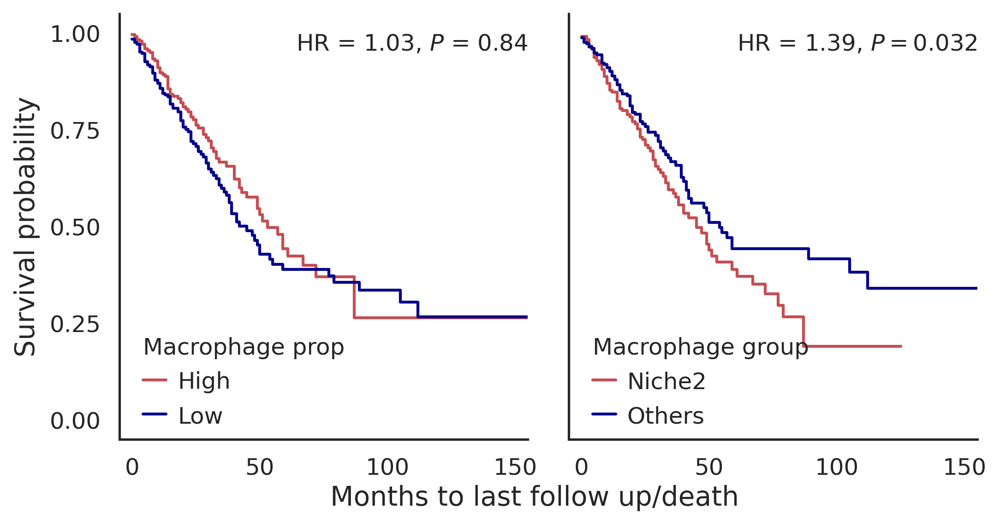

In [362]:
draw_surv_curve2(surv_prop, [ct, f'{ct1} prop'], texts=['HR = 1.03, $P$ = 0.84', 'HR = 1.39, $P = 0.032$'], text_pos=[155, 1],
                 leg_pos=(0.03,0.0), leg_titles=['Macrophage prop', 'Macrophage group'], labels=[['High', 'Low'], ['Niche2', 'Others']], figsize=(8,4))